In [167]:
import numpy as np
import pandas as pd

import random
from tqdm import tqdm
from sklearn.metrics.cluster import normalized_mutual_info_score

import matplotlib.pyplot as plt 
import plotly.graph_objects as go 
import seaborn as sns
from cycler import cycler

random.seed(30)

In [47]:
import os

if not os.path.exists("images"):
    os.mkdir("images")

# Speed Up Reading (csv-to-pickle)

## training set

In [3]:
# usecols
basecols = ['row_id', 'time_id', 'investment_id', 'target']
features = [f'f_{i}' for i in range(300)]

# dtypes
dtypes = {
    'row_id': 'str',
    'time_id': 'uint16',
    'investment_id': 'uint16',
    'target': 'float32',
}

for col in features:
    dtypes[col] = 'float32'


# Read data from csv
train = pd.read_csv('train.csv', usecols=basecols+features, dtype=dtypes)

# save as pickle file
train.to_pickle('train.pkl')

In [5]:
train = pd.read_pickle('train.pkl')

In [6]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3141410 entries, 0 to 3141409
Columns: 304 entries, row_id to f_299
dtypes: float32(301), object(1), uint16(2)
memory usage: 3.6+ GB


In [8]:
train.head(10)

,row_id,time_id,investment_id,target,f_0,f_1,f_2,f_3,f_4,f_5,...,f_290,f_291,f_292,f_293,f_294,f_295,f_296,f_297,f_298,f_299
0,0_1,0,1,-0.300875,0.932573,0.113691,-0.402206,0.378386,-0.203938,-0.413469,...,0.366028,-1.095620,0.200075,0.819155,0.941183,-0.086764,-1.087009,-1.044826,-0.287605,0.321566
1,0_2,0,2,-0.231040,0.810802,-0.514115,0.742368,-0.616673,-0.194255,1.771210,...,-0.154193,0.912726,-0.734579,0.819155,0.941183,-0.387617,-1.087009,-0.929529,-0.974060,-0.343624
2,0_6,0,6,0.568807,0.393974,0.615937,0.567806,-0.607963,0.068883,-1.083155,...,-0.138020,0.912726,-0.551904,-1.220772,-1.060166,-0.219097,-1.087009,-0.612428,-0.113944,0.243608
3,0_7,0,7,-1.064780,-2.343535,-0.011870,1.874606,-0.606346,-0.586827,-0.815737,...,0.382201,0.912726,-0.266359,-1.220772,0.941183,-0.609113,0.104928,-0.783423,1.151730,-0.773309
4,0_8,0,8,-0.531940,0.842057,-0.262993,2.330030,-0.583422,-0.618392,-0.742814,...,-0.170365,0.912726,-0.741355,-1.220772,0.941183,-0.588445,0.104928,0.753279,1.345611,-0.737624
5,0_9,0,9,1.505904,0.608855,1.369305,-0.761515,0.865860,-0.359269,-1.835762,...,0.333684,-1.095620,-0.335999,0.819155,-1.060166,-0.343812,-1.087009,0.077862,0.142943,-0.055550
6,0_10,0,10,-0.260731,-1.863797,0.113691,1.573864,-0.598433,-0.569936,0.398784,...,0.821560,0.912726,0.476309,-1.220772,0.941183,-0.434315,1.296864,0.171329,1.051288,-0.745335
7,0_12,0,12,-0.469207,0.408954,-0.765238,0.261430,-0.591895,-0.037260,0.668721,...,0.821560,-1.095620,-0.864354,-1.220772,-1.060166,-0.300218,1.296864,-0.779556,0.274961,-0.182520
8,0_13,0,13,0.094525,0.861187,2.373796,-1.148977,0.752205,-0.050502,-2.249047,...,-0.658241,0.912726,0.718282,0.819155,0.941183,4.198117,1.296864,1.854434,0.000000,-0.688340
9,0_14,0,14,-0.251120,-2.476555,0.239253,2.222353,-0.582276,-0.618236,0.386263,...,0.821560,-1.095620,-0.615709,-1.220772,-1.060166,-0.647769,0.104928,-0.849789,0.805876,-0.820165


In [9]:
train.shape

(3141410, 304)

## test set

In [10]:
test = pd.read_csv('example_test.csv')

In [11]:
test.head(10)

,row_id,time_id,investment_id,f_0,f_1,f_2,f_3,f_4,f_5,f_6,...,f_290,f_291,f_292,f_293,f_294,f_295,f_296,f_297,f_298,f_299
0,1220_1,1220,1,0.874944,0.457875,0.962572,0.372061,0.004509,0.971304,0.097477,...,0.514031,0.828523,0.437697,0.810764,0.693963,0.186403,0.569144,0.120386,0.419603,0.936966
1,1220_2,1220,2,0.554862,0.445478,0.714034,0.891988,0.703331,0.264478,0.600636,...,0.620919,0.301540,0.687464,0.400168,0.908198,0.272901,0.222430,0.748324,0.858802,0.362829
2,1221_0,1221,0,0.175070,0.918464,0.044379,0.505868,0.037160,0.169001,0.211365,...,0.397710,0.789382,0.238078,0.254068,0.795084,0.491928,0.376725,0.079489,0.995041,0.482283
3,1221_1,1221,1,0.355239,0.689773,0.452643,0.134863,0.794958,0.837197,0.036773,...,0.893571,0.322879,0.674692,0.114160,0.818483,0.287065,0.710537,0.550434,0.899869,0.928997
4,1221_2,1221,2,0.912778,0.462684,0.454067,0.491009,0.050547,0.250051,0.686295,...,0.031662,0.703427,0.861476,0.897927,0.659051,0.356148,0.375990,0.209798,0.175153,0.727160
5,1222_0,1222,0,0.678116,0.158996,0.058148,0.253677,0.984982,0.323493,0.307990,...,0.439604,0.487491,0.080697,0.539750,0.246645,0.435054,0.436709,0.315042,0.133657,0.731483
6,1222_1,1222,1,0.769912,0.060028,0.676047,0.853550,0.411155,0.747515,0.649063,...,0.419152,0.659254,0.198072,0.655397,0.428209,0.769999,0.960219,0.734675,0.028576,0.320976
7,1222_2,1222,2,0.738876,0.980038,0.696796,0.591012,0.882052,0.311484,0.729229,...,0.341144,0.758328,0.010728,0.276859,0.979913,0.486605,0.670140,0.515824,0.580929,0.139308
8,1223_0,1223,0,0.281445,0.571472,0.986828,0.021403,0.789577,0.005765,0.409379,...,0.357828,0.000019,0.504530,0.169174,0.216349,0.503643,0.052721,0.795965,0.909602,0.291668


In [12]:
test.shape

(9, 303)

## submission example

In [13]:
sub_example = pd.read_csv('example_sample_submission.csv')

In [14]:
sub_example.head()

,row_id,time_id,target
0,1220_1,1220,0
1,1220_2,1220,0
2,1221_0,1221,0
3,1221_1,1221,0
4,1221_2,1221,0


In [16]:
sub_example.shape

(9, 3)

# EDA

In [17]:
train.describe()

,time_id,investment_id,target,f_0,f_1,f_2,f_3,f_4,f_5,f_6,...,f_290,f_291,f_292,f_293,f_294,f_295,f_296,f_297,f_298,f_299
count,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,...,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06,3.141410e+06
mean,6.654862e+02,1.885265e+03,-2.109231e-02,1.637028e-03,-1.257750e-02,8.514524e-03,-2.003680e-02,-5.416394e-03,-3.034038e-03,1.934293e-03,...,1.257388e-02,8.997587e-04,-6.509002e-03,2.850204e-03,-4.732862e-03,-2.773726e-02,-1.517807e-03,-7.058299e-03,-4.216855e-03,-4.319444e-03
std,3.560434e+02,1.083616e+03,9.197057e-01,1.081097e+00,1.032447e+00,1.031786e+00,9.630771e-01,9.943870e-01,1.105940e+00,1.068882e+00,...,1.085783e+00,1.114992e+00,1.071597e+00,1.103297e+00,1.145119e+00,9.608897e-01,1.141631e+00,1.109445e+00,1.052312e+00,1.010046e+00
min,0.000000e+00,0.000000e+00,-9.419646e+00,-1.765789e+01,-6.579473e+00,-8.644268e+00,-1.800427e+01,-4.000015e+00,-8.833704e+00,-6.384251e+00,...,-9.271487e+00,-6.359966e+00,-8.183732e+00,-2.399478e+01,-1.497270e+01,-9.348986e+00,-7.366648e+00,-7.579406e+00,-6.707284e+00,-1.028264e+01
25%,3.530000e+02,9.520000e+02,-5.004572e-01,-4.071441e-01,-6.813878e-01,-6.530838e-01,-4.496046e-01,-3.532303e-01,-7.070855e-01,-7.911198e-01,...,-6.037326e-01,-8.355157e-01,-6.981400e-01,-1.377131e-01,-9.397985e-01,-5.147926e-01,-9.573807e-01,-7.239380e-01,-8.165390e-01,-5.080143e-01
50%,7.040000e+02,1.882000e+03,-9.717009e-02,2.431158e-01,-4.867587e-02,4.350941e-02,-2.639937e-01,-1.908876e-01,-2.144796e-02,1.437945e-02,...,6.086323e-02,-2.023181e-01,-1.910102e-01,2.164071e-01,2.087202e-01,-2.907780e-01,6.955573e-03,-1.650222e-01,2.300689e-02,-2.824031e-01
75%,9.750000e+02,2.830000e+03,3.572908e-01,6.649507e-01,6.086557e-01,6.587324e-01,7.763371e-02,2.784694e-02,6.835684e-01,8.008306e-01,...,6.882384e-01,9.035954e-01,4.841421e-01,5.088849e-01,8.616266e-01,1.275946e-01,9.503851e-01,6.098197e-01,7.984827e-01,1.411301e-01
max,1.219000e+03,3.773000e+03,1.203861e+01,7.845261e+00,8.707207e+00,8.009340e+00,4.706333e+01,7.662866e+01,7.646200e+00,6.778142e+00,...,9.298274e+00,9.725060e+00,2.231185e+01,6.587691e+00,6.978151e+00,6.140367e+01,7.679950e+00,1.241804e+01,7.003982e+00,4.337021e+01


## Missing Values
- There's no missing values in training set.

In [18]:
assert not train.isna().any().any()

## `time_id`

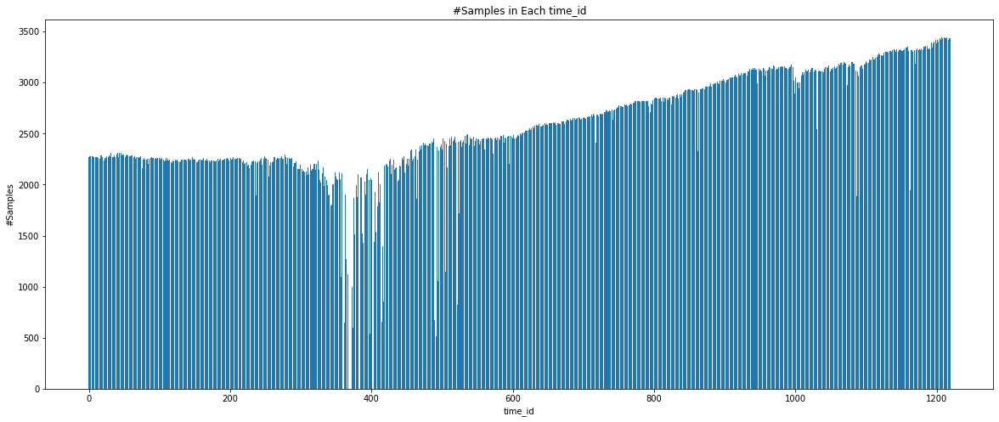

In [27]:
n_samples_time_id = train.groupby('time_id').agg('size')
assert n_samples_time_id.equals(train.groupby('time_id')['investment_id'].nunique())

fig, ax = plt.subplots(figsize=(14, 7))
ax.bar(n_samples_time_id.index, n_samples_time_id.values)
ax.set_title("#Samples in Each time_id")
ax.set_xlabel("time_id")
ax.set_ylabel("#Samples")

fig.set_size_inches(20, 8)
fig.savefig('images/samples_num_each_time_id.png', dpi=100)

plt.show()

In [28]:
print(f"Maximum #samples in one time_id is {n_samples_time_id.max()}, "
      f"the corresponding time_id is {n_samples_time_id.index[n_samples_time_id.argmax()]}.")
print(f"Minimum #samples in one time_id is {n_samples_time_id.min()}, "
      f"the corresponding time_id is {n_samples_time_id.index[n_samples_time_id.argmin()]}.")

Maximum #samples in one time_id is 3445, the corresponding time_id is 1214.
Minimum #samples in one time_id is 512, the corresponding time_id is 492.


In [134]:
train[train.time_id == 1214].groupby(by='time_id').target.mean()

time_id
1214   -0.004559
Name: target, dtype: float32

In [135]:
train[train.time_id == 492].groupby(by='time_id').target.mean()

time_id
492    0.63633
Name: target, dtype: float32

## `investment_id`

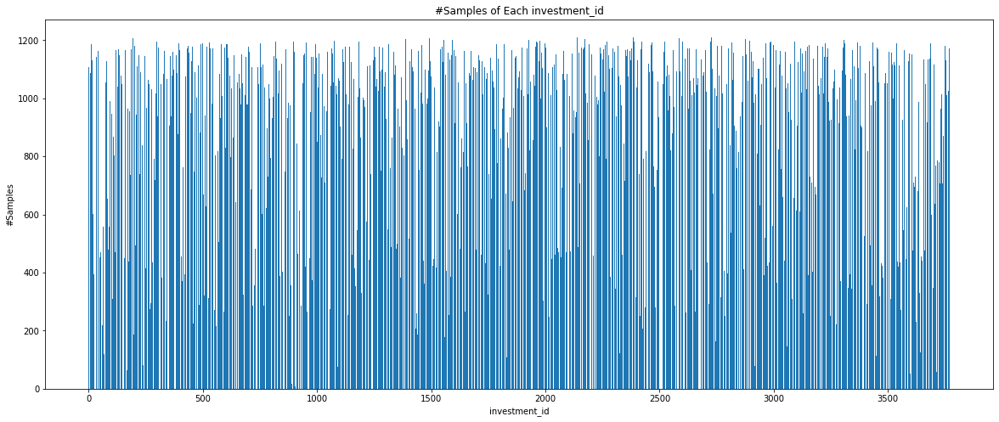

In [30]:
n_samples_inv_id = train.groupby('investment_id').agg('size')
assert n_samples_inv_id.equals(train.groupby('investment_id')['time_id'].nunique())

fig, ax = plt.subplots(figsize=(14, 7))
ax.bar(n_samples_inv_id.index, n_samples_inv_id.values)
ax.set_title("#Samples of Each investment_id")
ax.set_xlabel("investment_id")
ax.set_ylabel("#Samples")

fig.set_size_inches(20, 8)
fig.savefig('images/samples_num_each_investment_id.png', dpi=100)

plt.show()

In [31]:
print(f"Maximum #samples of one investment_id is {n_samples_inv_id.max()}, "
      f"the corresponding investment_id is {n_samples_inv_id.index[n_samples_inv_id.argmax()]}.")
print(f"Minimum #samples of one investment_id is {n_samples_inv_id.min()}, "
      f"the corresponding investment_id is {n_samples_inv_id.index[n_samples_inv_id.argmin()]}.")

Maximum #samples of one investment_id is 1211, the corresponding investment_id is 2140.
Minimum #samples of one investment_id is 2, the corresponding investment_id is 1415.


In [136]:
train[train.investment_id == 2140].groupby(by='investment_id').target.mean()

investment_id
2140    0.014647
Name: target, dtype: float32

In [140]:
train[train.investment_id == 1415].groupby(by='investment_id').target.mean()

investment_id
1415    0.0
Name: target, dtype: float32

## `target`
- `target` seems to be close to normal distribution, no obvious outliers or noise. Not skewed as well. No transformation necessary needed.

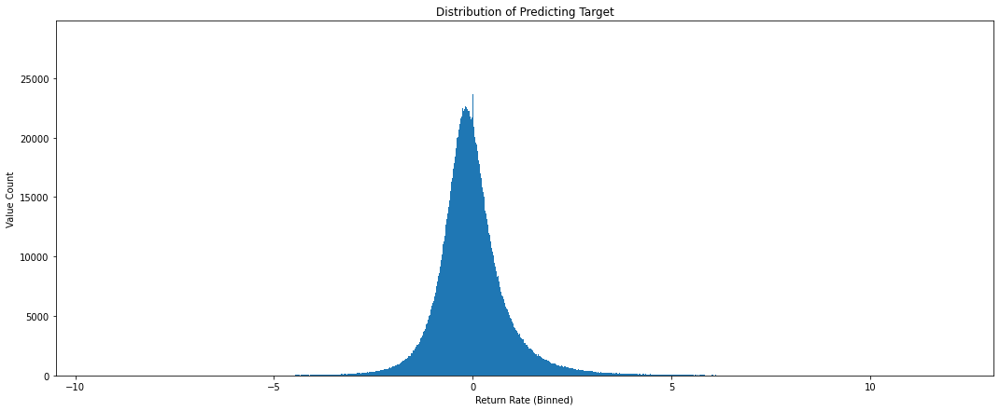

In [34]:
fig, ax = plt.subplots(figsize=(18, 7))
ax.hist(train['target'], bins=2000)
ax.set_title("Distribution of Predicting Target")
ax.set_xlabel("Return Rate (Binned)")
ax.set_ylabel("Value Count")

fig.savefig('images/target_distribution.png', dpi=100)

plt.show()

On a high-level target for each investment_id also looks ok.

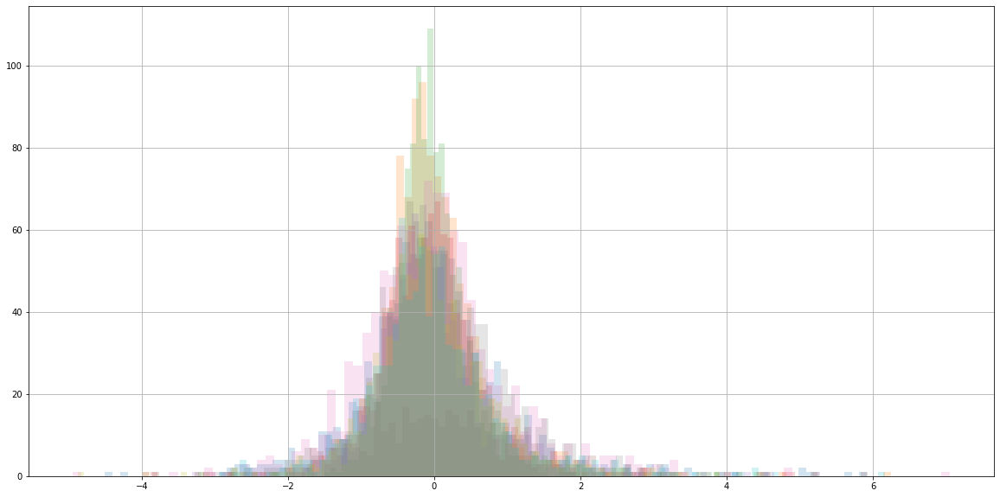

In [102]:
for f in np.random.choice(train['investment_id'].unique(), 10):
    train[train['investment_id'] == f]['target'].hist(bins = 100, alpha = 0.2, figsize = (20,10))

do time series of `target` given `time_id` and `investment_id`

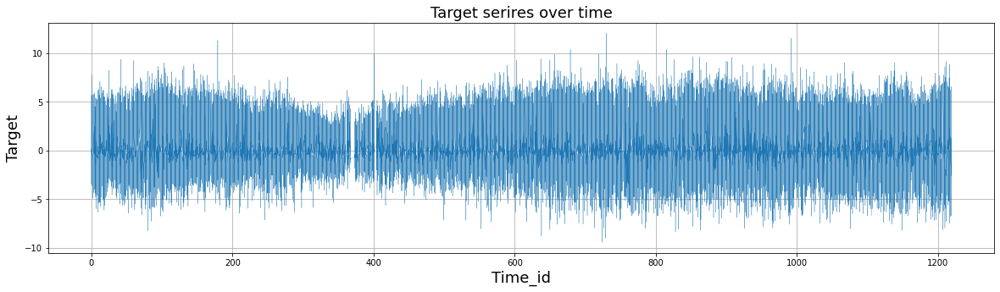

In [149]:
plt.figure(figsize=(20,5))
plt.title ('Target serires over time', fontsize=18)
plt.plot(train['time_id'], train['target'], lw=0.3);
plt.ylabel (f'Target', fontsize=18);
plt.xlabel ('Time_id', fontsize=18)
plt.grid()
plt.savefig('images/target_series_over_time.png', dpi=100)
plt.show()

Assuming an uniform investment (all investment have the same weight), the overall investment is in loss

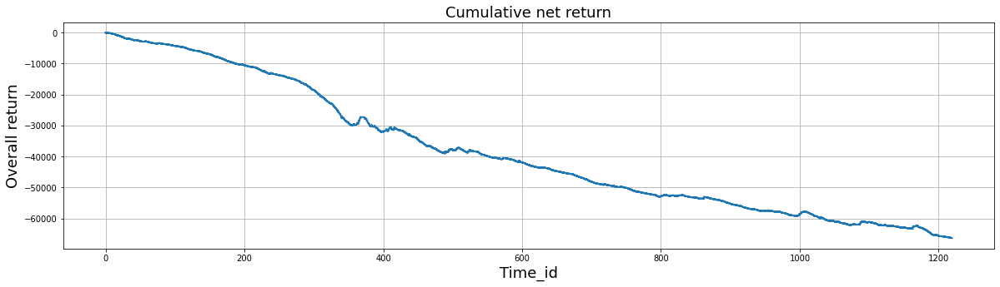

In [148]:
plt.figure(figsize=(20,5))
plt.title ('Cumulative net return', fontsize=18)
plt.plot(train['time_id'], train['target'].cumsum(), lw=2);
plt.ylabel (f'Overall return', fontsize=18);
plt.xlabel ('Time_id', fontsize=18)
plt.grid()
plt.savefig('images/cumulated_target_over_time.png')
plt.show()

Target series of some individual investment ids

In [144]:
time_ids_complete = [t for t in range(train['time_id'].min(), train['time_id'].max())]
inv_ids_rand = random.sample(list(train['investment_id'].unique()), k=5)

fig = go.Figure()
for i, inv_id in tqdm(enumerate(inv_ids_rand)):
    target_ = train[train['investment_id'] == inv_id].loc[:, ['time_id', 'target']]
    target_.sort_values('time_id', inplace=True)
    target_.set_index('time_id', drop=True, inplace=True)
    target_ = target_.reindex(index=time_ids_complete)
    
    fig.add_trace(go.Scatter(x=time_ids_complete, y=target_['target'], 
                             mode='lines+markers', name=f'inv_{inv_id}'))
    del target_
    
fig.update_layout(
    title="Target Series of Different Investments",
    xaxis_title="time_id",
    yaxis_title="Return Rate",
    legend_title="investment_id",
)

fig.show()

5it [00:08,  1.63s/it]


check the cumulated return rate of some individual investments

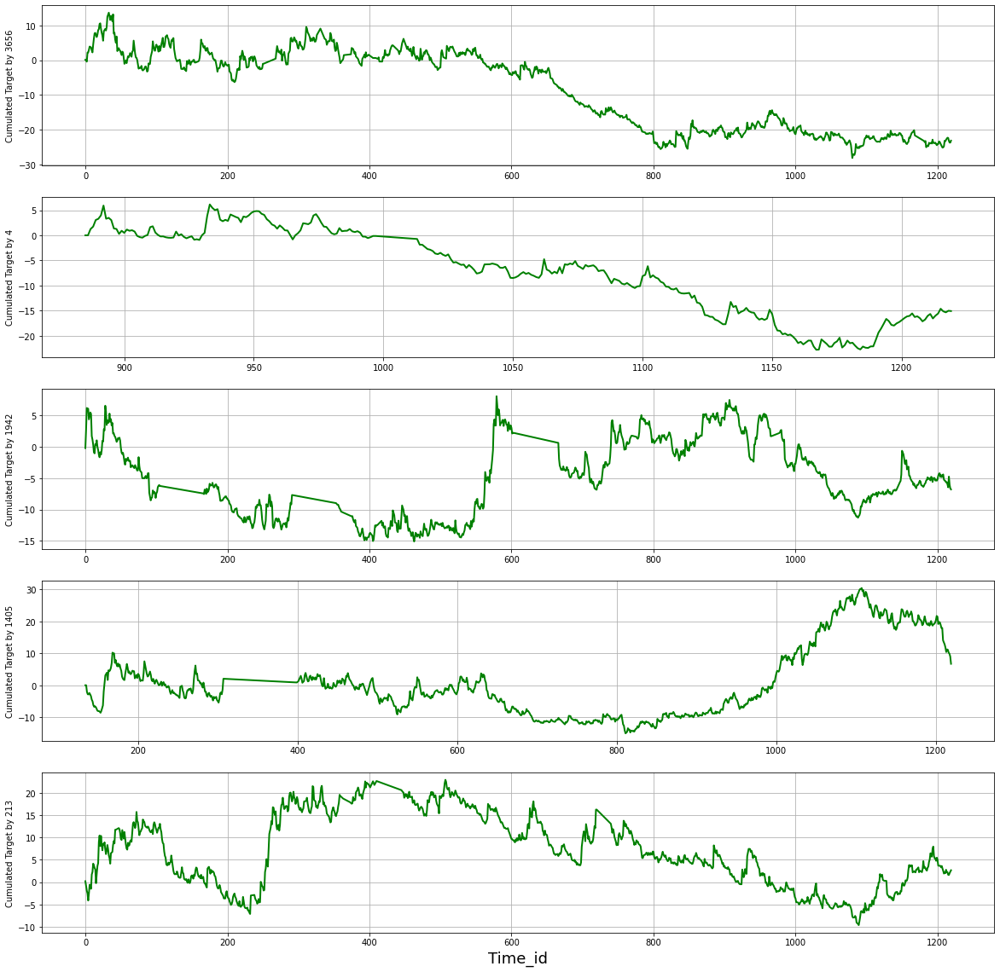

In [155]:
plt.figure(figsize=(20,20))
for i in range(5):
    plt.subplot(5,1,i+1)
    cumReturn = train.loc[train['investment_id']==inv_ids_rand[i],'target'].cumsum()
    time_id = train.loc[train['investment_id']==inv_ids_rand[i],'time_id']
    plt.plot(time_id, cumReturn, color='green', lw=2);
    plt.ylabel (f'Cumulated Target by {inv_ids_rand[i]}');
    plt.grid()
plt.xlabel ('Time_id', fontsize=18)
plt.savefig('images/cumulated_target_over_time_sample.png')

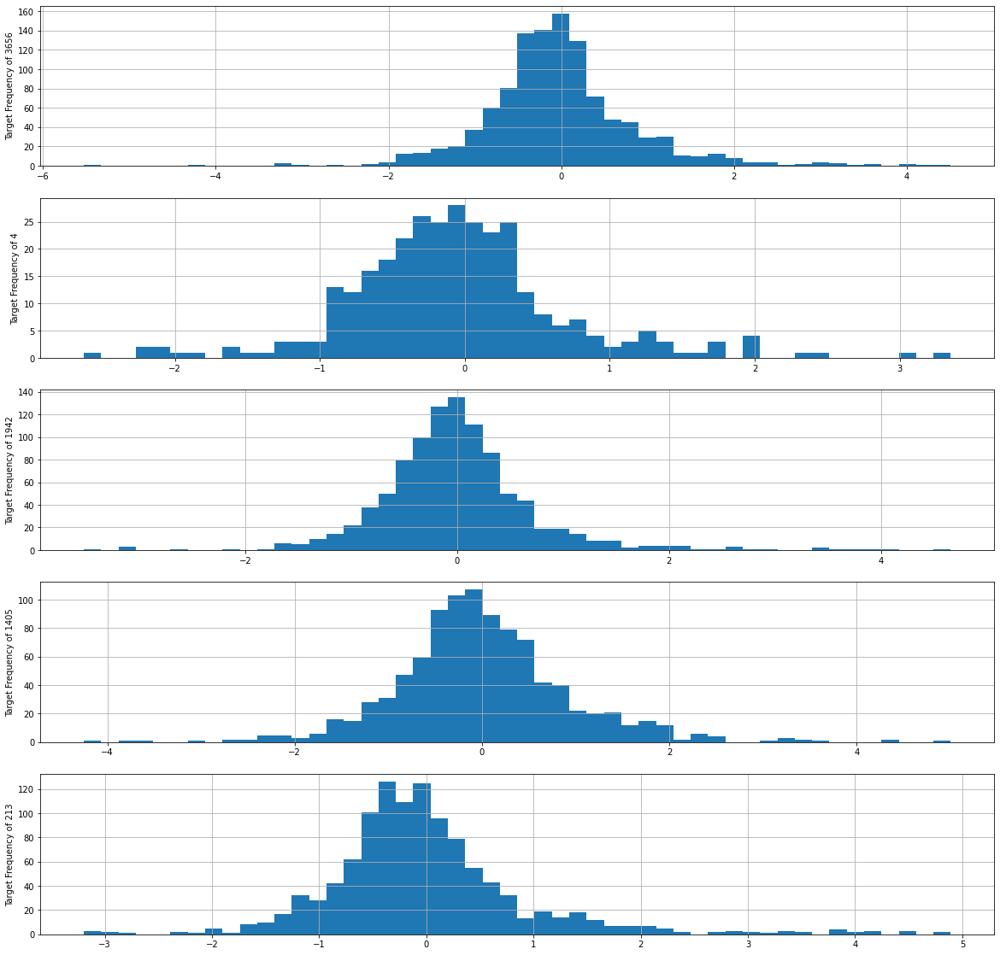

In [156]:
# plot target for specific investment
plt.figure(figsize=(20,20))
for i in range(5):
    plt.subplot(5,1,i+1)
    train[train.investment_id == inv_ids_rand[i]].target.plot(kind='hist', bins=50)
    plt.ylabel (f'Target Frequency of {inv_ids_rand[i]}')
    plt.grid()
plt.savefig('images/target_freq_over_investment_id.png')

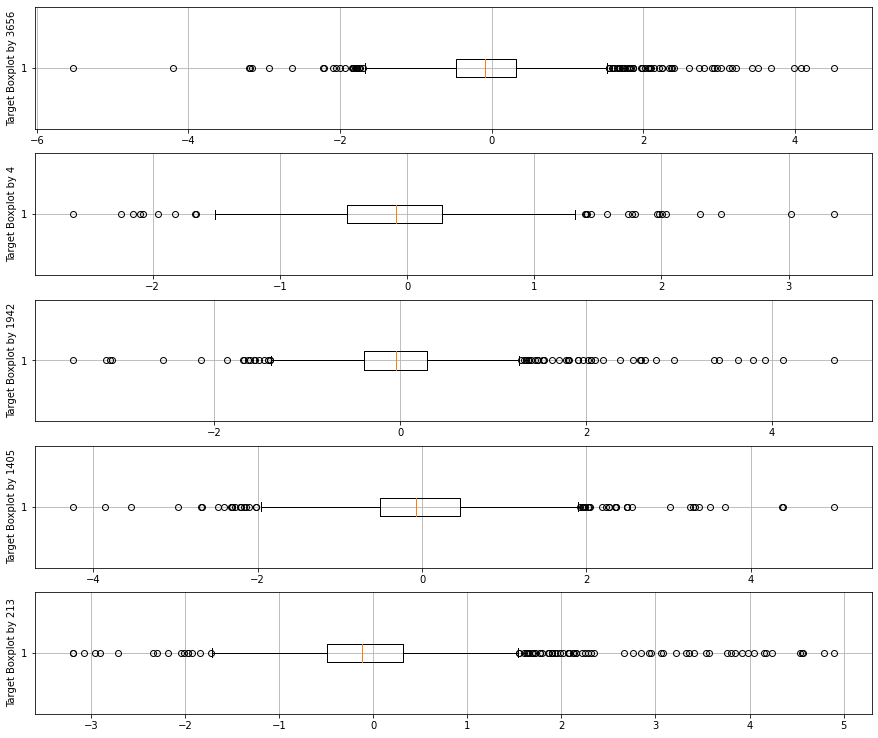

In [164]:
# boxplot
plt.figure(figsize=(15,13))
for i in range(5):
    plt.subplot(5,1,i+1)
    plt.boxplot( train[train.investment_id == inv_ids_rand[i]].target, vert=False)
    plt.ylabel (f'Target Boxplot by {inv_ids_rand[i]}')
    plt.grid()
plt.savefig('images/target_boxplot_over_investment_id.png')
plt.show()

In [57]:
target_map = train.pivot(index='investment_id', columns='time_id', values='target')
target_map.head(2)

time_id,0,1,2,3,4,5,6,7,8,9,...,1210,1211,1212,1213,1214,1215,1216,1217,1218,1219
investment_id,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.472723,-0.236285,-2.621014,0.129619,1.138975,0.579622,0.064896,2.204664,1.037581,-2.631323
1,-0.300875,-0.917045,-0.480234,-0.323562,2.494479,0.299347,-1.381707,0.913922,-0.661152,-0.867373,...,0.072360,-0.071978,0.135815,0.226359,-0.167262,0.078338,-0.290113,-0.097136,-0.080295,0.656833


return rate follows a random walk?

In [158]:
inv_ids_rand_50 = random.sample(list(target_map.index.unique()), 50)

fig = go.Figure()
for i, inv_id in tqdm(enumerate(inv_ids_rand_50)):
    target_vec = target_map[target_map.index == inv_id].values[0]
    target_cumsum = np.nancumsum(target_vec)
    
    fig.add_trace(go.Scatter(x=target_map.columns, y=target_cumsum, 
                             mode='lines', name=f'inv_{inv_id}'))
    del target_vec, target_cumsum
    
fig.update_layout(
    title="Cumulative Return Rate of Different Investments",
    xaxis_title="time_id",
    yaxis_title="Cumulative Return Rate",
    legend_title="investment_id",
)
fig.show()

50it [00:00, 1703.01it/s]


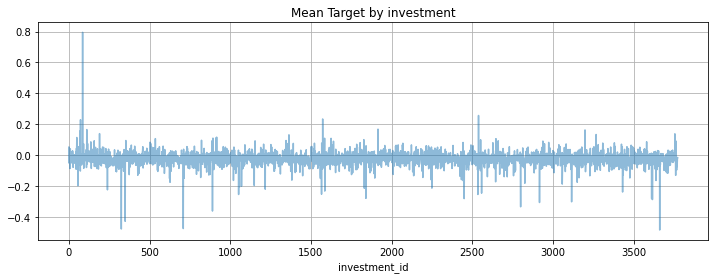

In [122]:
# mean by investment
plt.figure(figsize=(12,4))
train.groupby(by='investment_id').target.mean().plot(alpha=0.5)
plt.title('Mean Target by investment')
plt.grid()
plt.savefig('images/mean_target_by_investments.png')
plt.show()

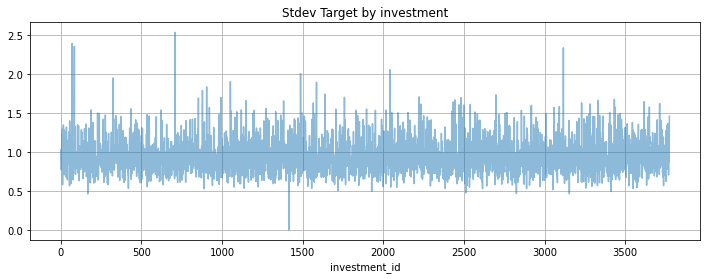

In [125]:
# standard deviation by investment
plt.figure(figsize=(12,4))
train.groupby(by='investment_id').target.std().plot(alpha=0.5)
plt.title('Stdev Target by investment')
plt.grid()
plt.savefig('images/sd_target_by_investments.png')
plt.show()

## Feature Correlation

derive correlations of return rate series of different `investment_id`s

In [63]:
corrs_inv = target_map.T.corr()   # Derive corr of return rates of different invs
corrs_inv = abs(corrs_inv[corrs_inv != 1])   # Take off-diagonal corrs
inv_ids_leg = list(n_samples_inv_id[n_samples_inv_id > 600].index)
corrs_inv = corrs_inv.loc[inv_ids_leg, inv_ids_leg]

corrs_max = {'inv_id1': [], 'inv_id2': [], 'corr': []}
for inv_id, corr_vec in corrs_inv.iterrows():
    corrs_max['inv_id1'].append(inv_id)
    corrs_max['inv_id2'].append(corr_vec.index[corr_vec.argmax()])
    corrs_max['corr'].append(corr_vec.max())
corrs_max = pd.DataFrame.from_dict(corrs_max, orient='columns')
corrs_max.sort_values('corr', ascending=False, inplace=True)

In [64]:
corrs_max.head(10)

,inv_id1,inv_id2,corr
139,194,1144,0.945091
848,1144,194,0.945091
830,1121,194,0.943145
1780,2406,1144,0.941287
1967,2669,1929,0.917952
1431,1929,2669,0.917952
355,485,1121,0.911926
2286,3092,485,0.907647
425,580,1104,0.894150
816,1104,580,0.894150


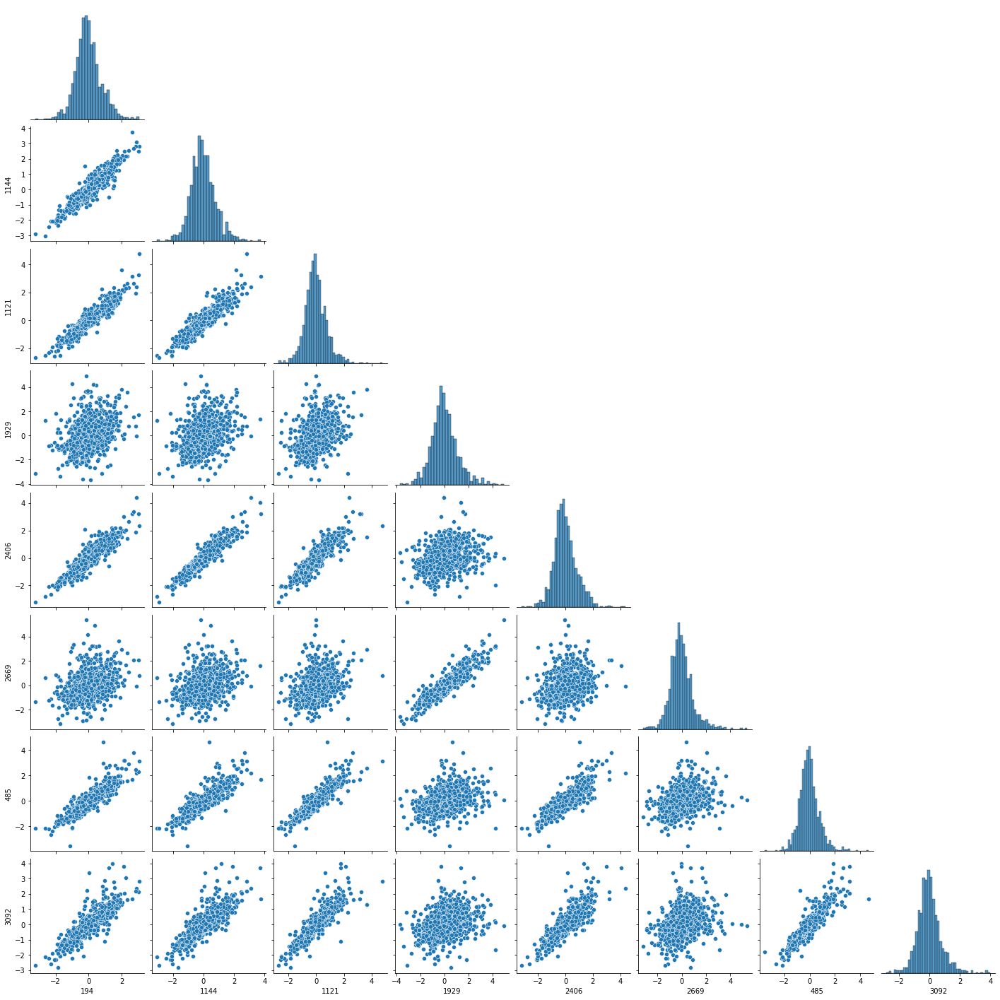

In [67]:
inv_ids_top = [194, 1144, 1121, 1929, 2406, 2669, 485, 3092]
target_map_ = target_map.loc[inv_ids_top, :]
sns.pairplot(target_map_.T, corner=True)
plt.savefig('images/highly_corr_investments.png')

## Feature Distribution

<AxesSubplot:>

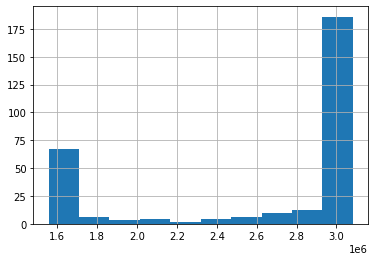

In [103]:
train[[f'f_{i}' for i in range(300)]].nunique().hist()

Cumulated features of some investments

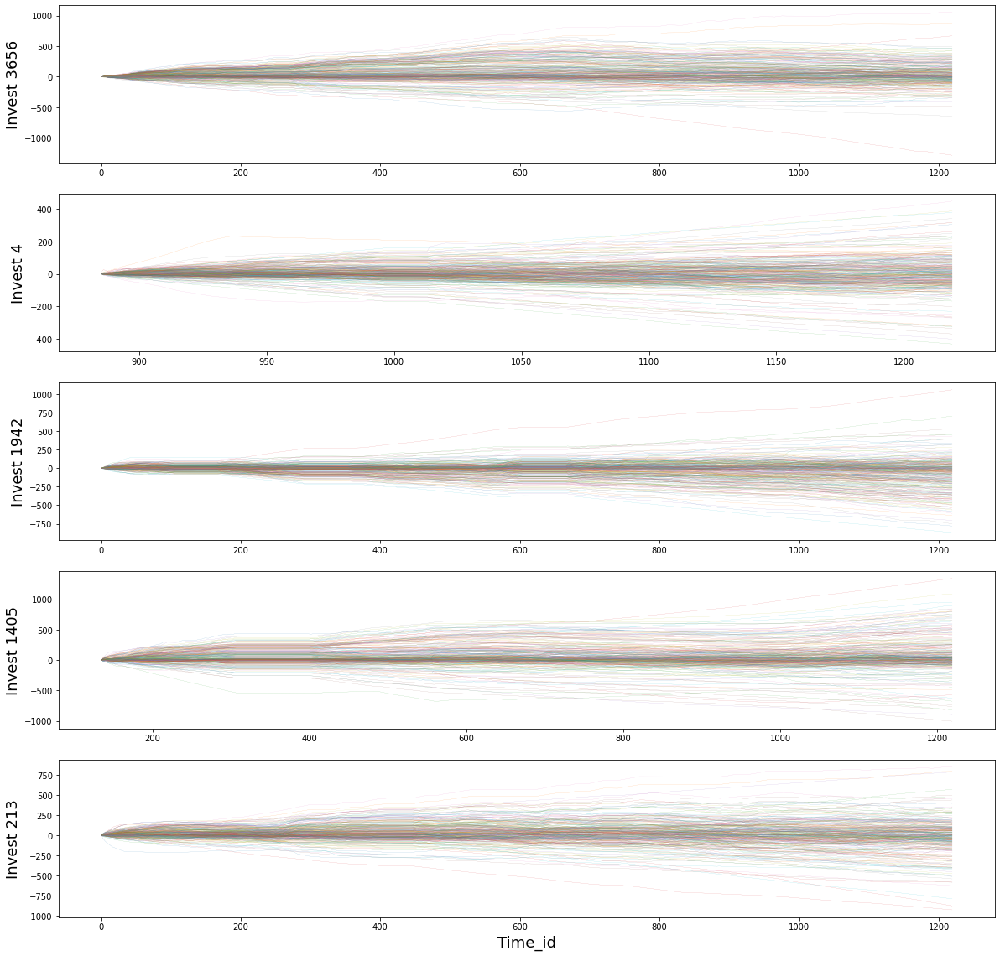

In [165]:
plt.figure(figsize=(20,20))
for i in range(5):
    plt.subplot(5,1,i+1)
    for j in range(300):
        feature = train.loc[train['investment_id']==inv_ids_rand[i], f'f_{j}'].cumsum()
        time_id = train.loc[train['investment_id']==inv_ids_rand[i], 'time_id']
        plt.plot(time_id, feature, lw=0.1);
    plt.ylabel (f'Invest {inv_ids_rand[i]}', fontsize=18);

plt.xlabel ('Time_id', fontsize=18)
plt.savefig('images/cumulated_features_over_time_sample.png')

### f_0 - f_24

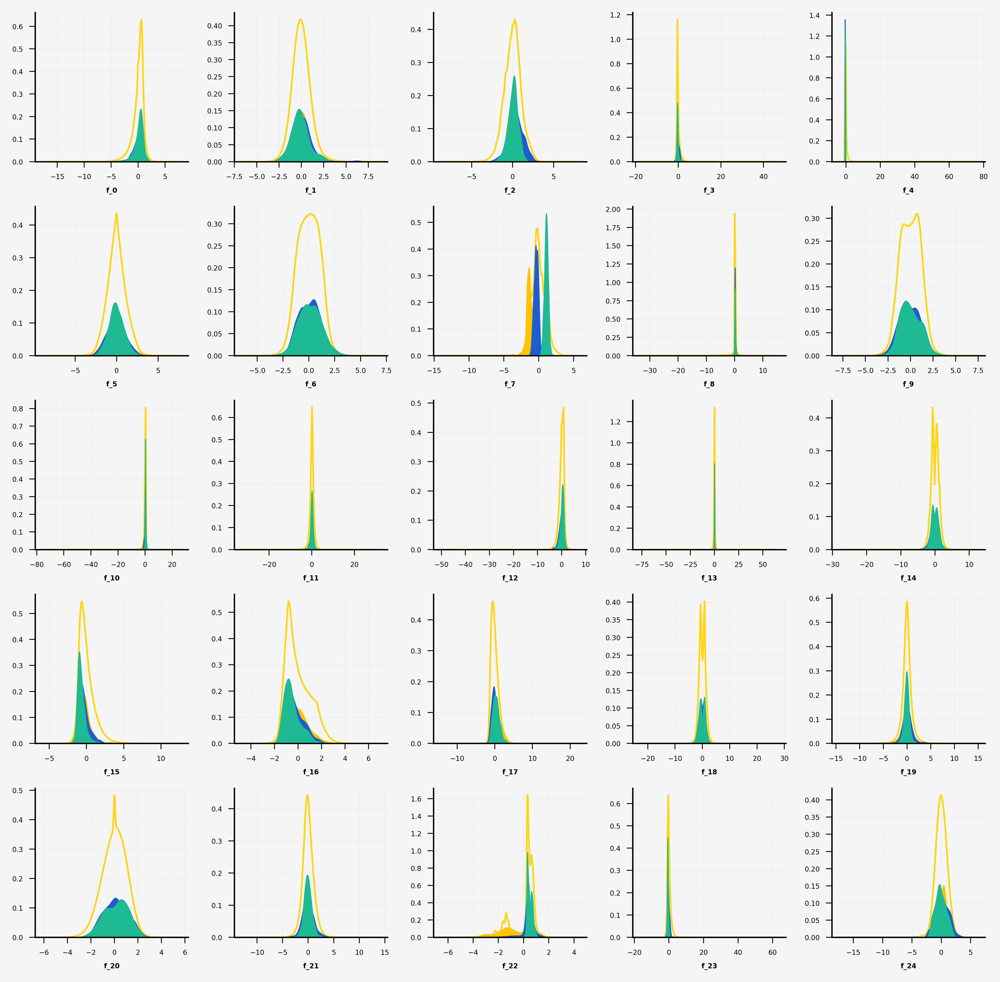

In [174]:
plot_feature_distribution(train, list(train.columns[4:29]), 'images/feature_importance_0_24.png')

### f_25 - f_49

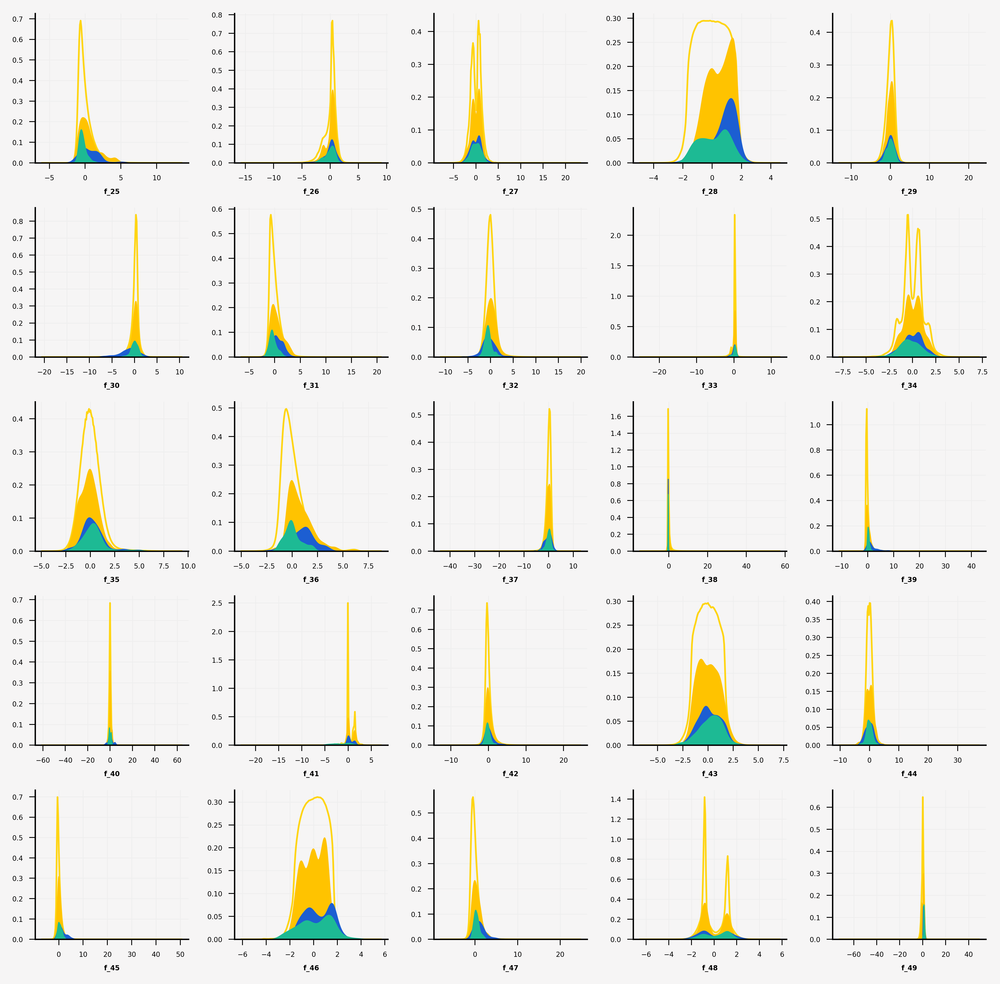

In [175]:
plot_feature_distribution(train, list(train.columns[29:54]), 'images/feature_importance_25_49.png')

### f_50 - f_74

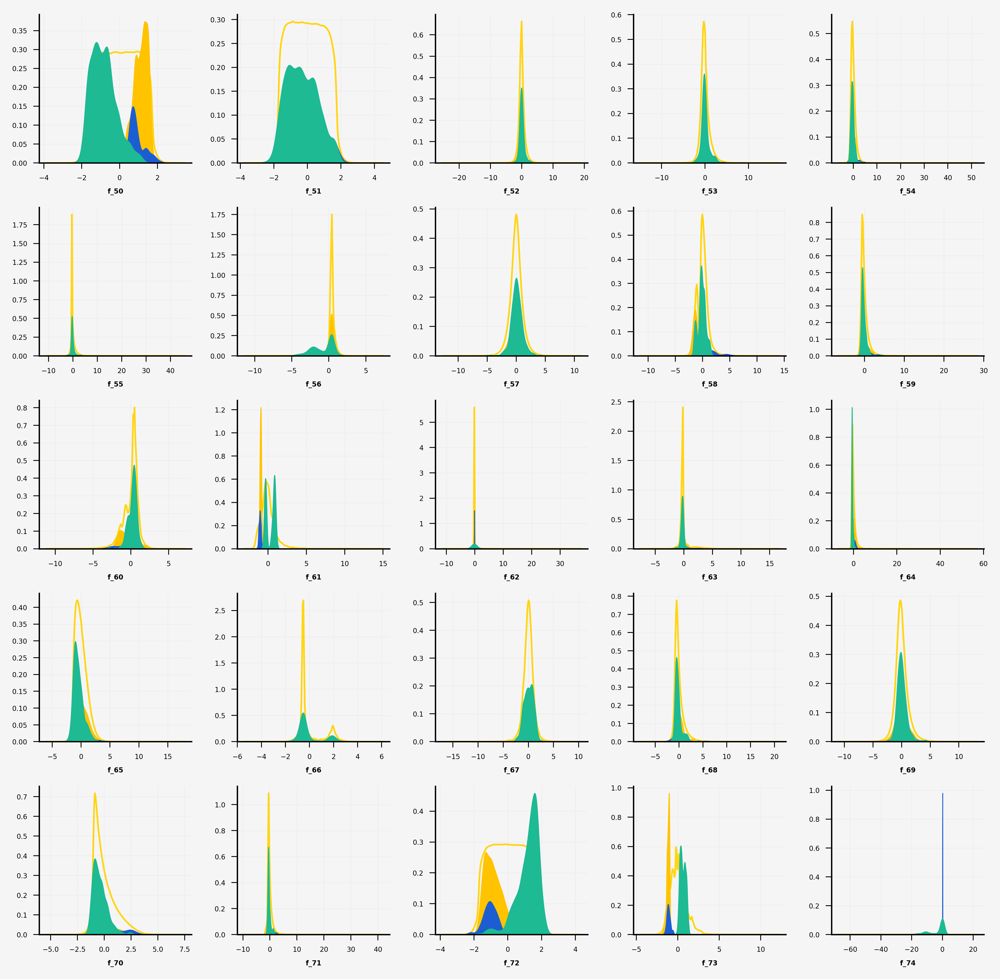

In [176]:
plot_feature_distribution(train, list(train.columns[54:79]), 'images/feature_importance_50_74.png')

### f_75 - f_99

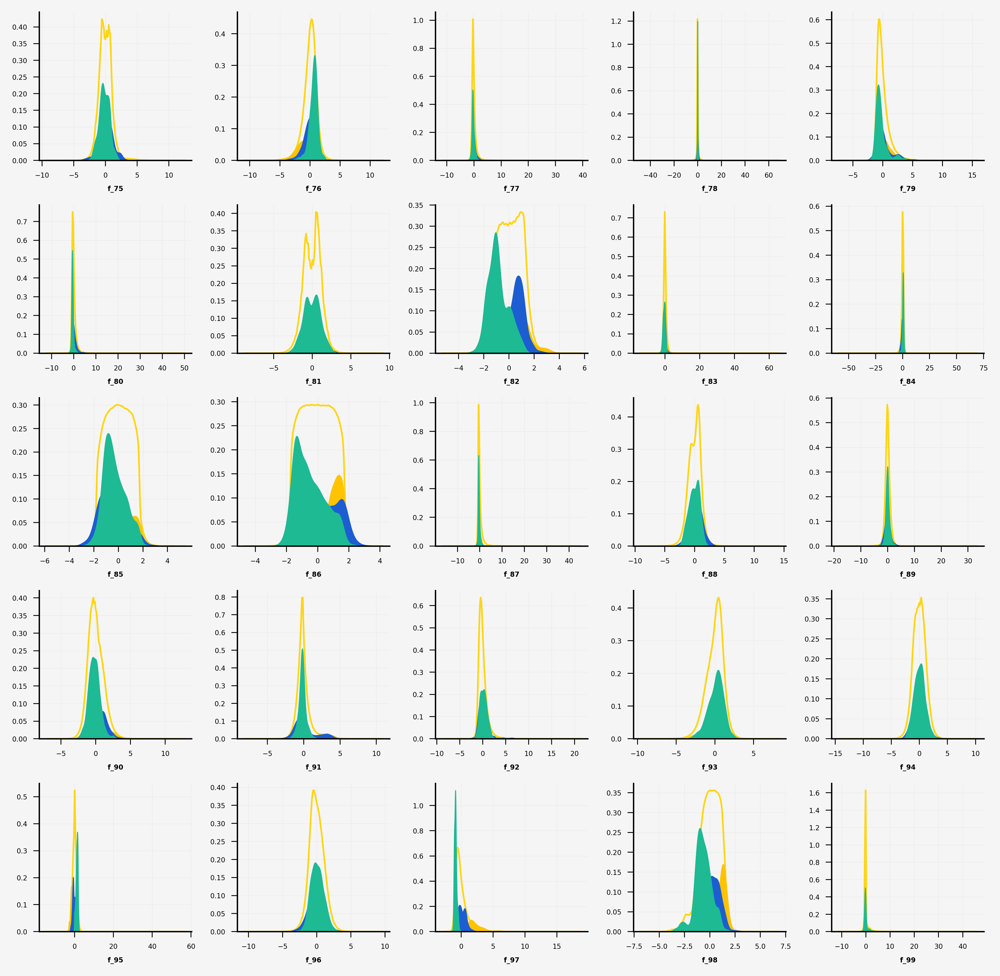

In [177]:
plot_feature_distribution(train, list(train.columns[79:104]), 'images/feature_importance_75_99.png')

### f_100 - f_124

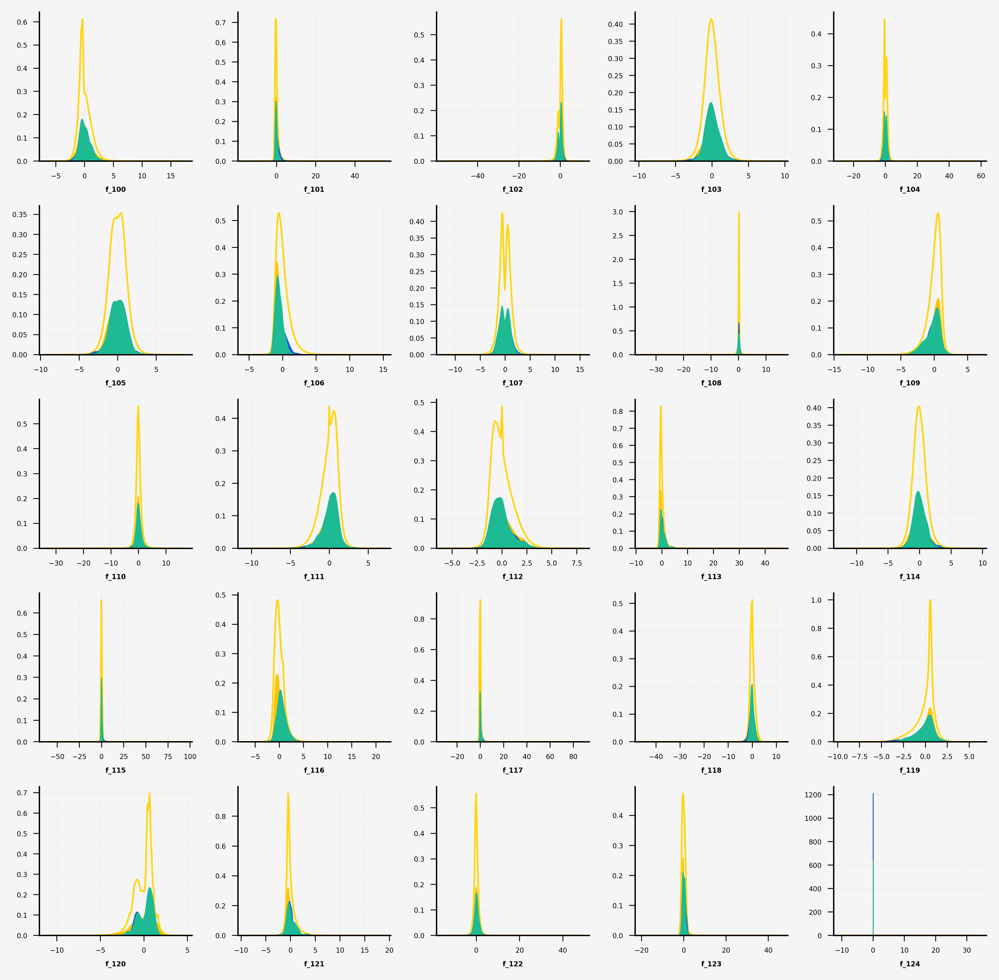

In [178]:
plot_feature_distribution(train, list(train.columns[104:129]), 'images/feature_importance_100_124.png')

### f_125 - f_149

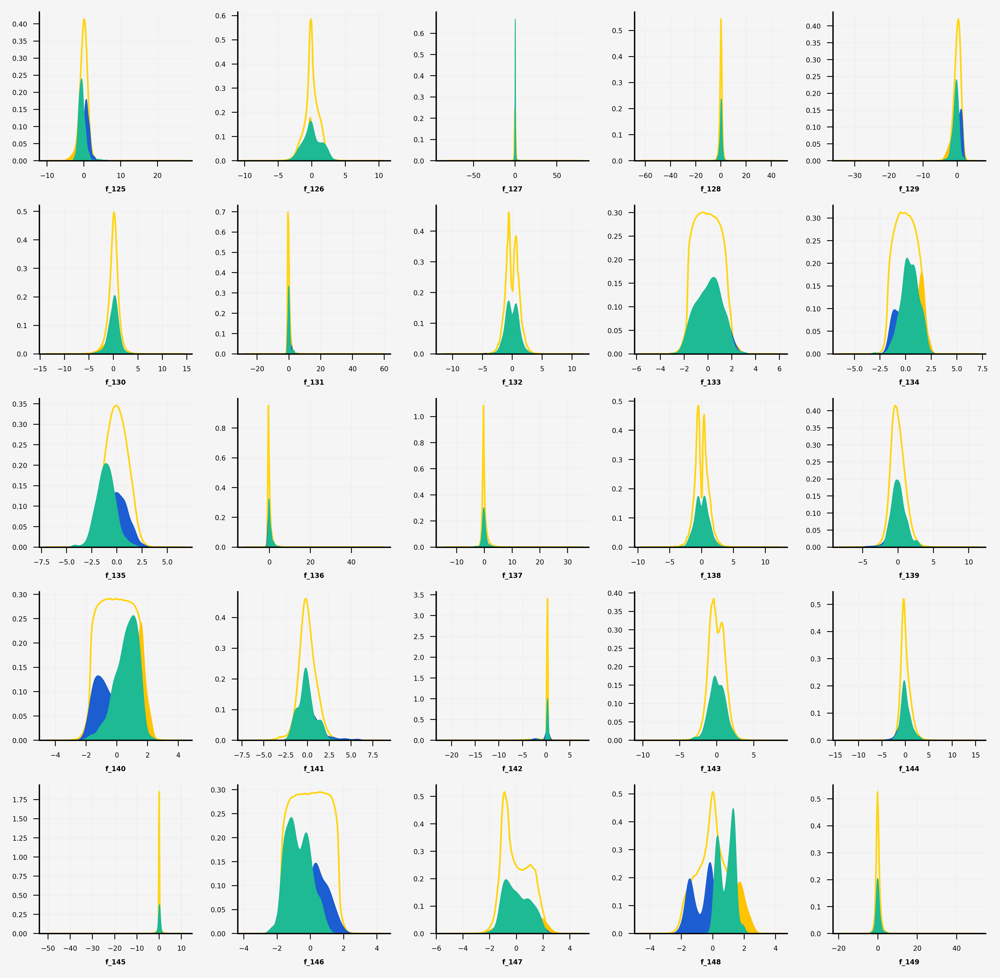

In [179]:
plot_feature_distribution(train, list(train.columns[129:154]), 'images/feature_importance_125_149.png')

### f_150 - f_174

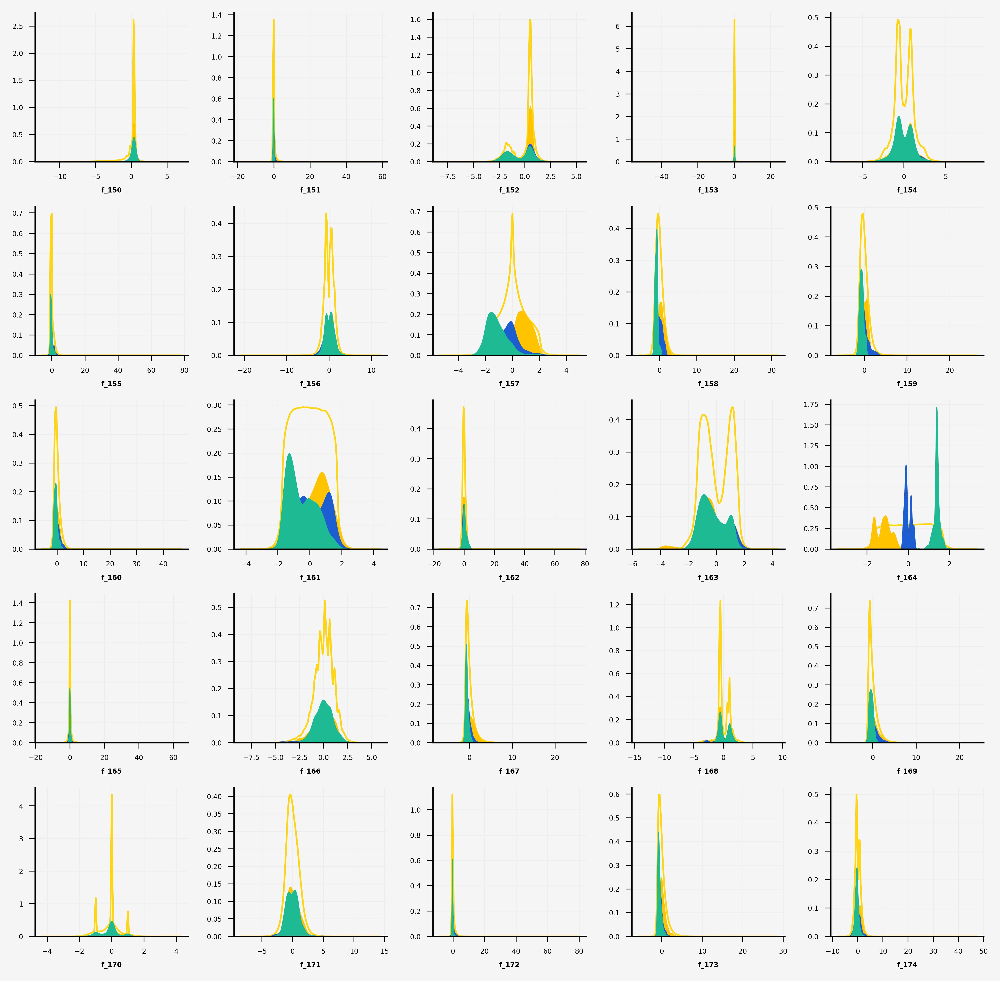

In [180]:
plot_feature_distribution(train, list(train.columns[154:179]), 'images/feature_importance_150_174.png')

### f_175 - f_199

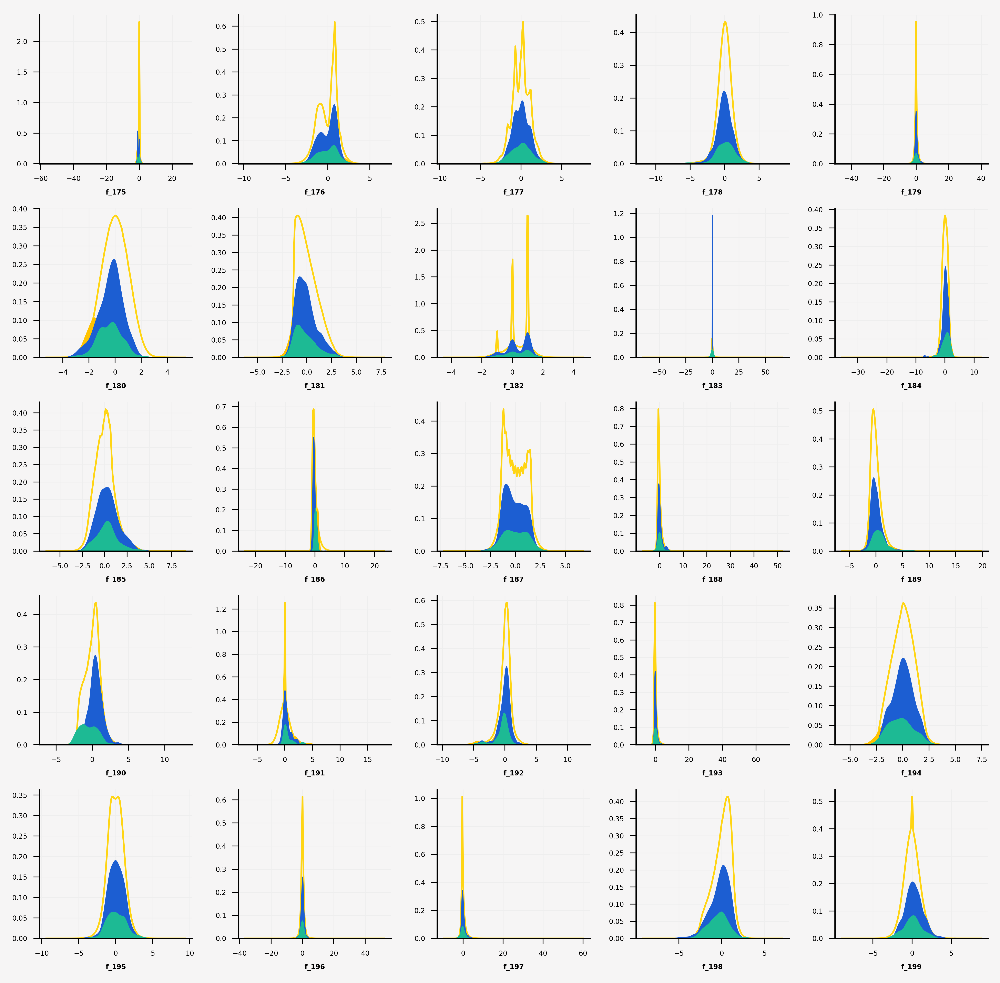

In [181]:
plot_feature_distribution(train, list(train.columns[179:204]), 'images/feature_importance_175_199.png')

### f_200 - f_224

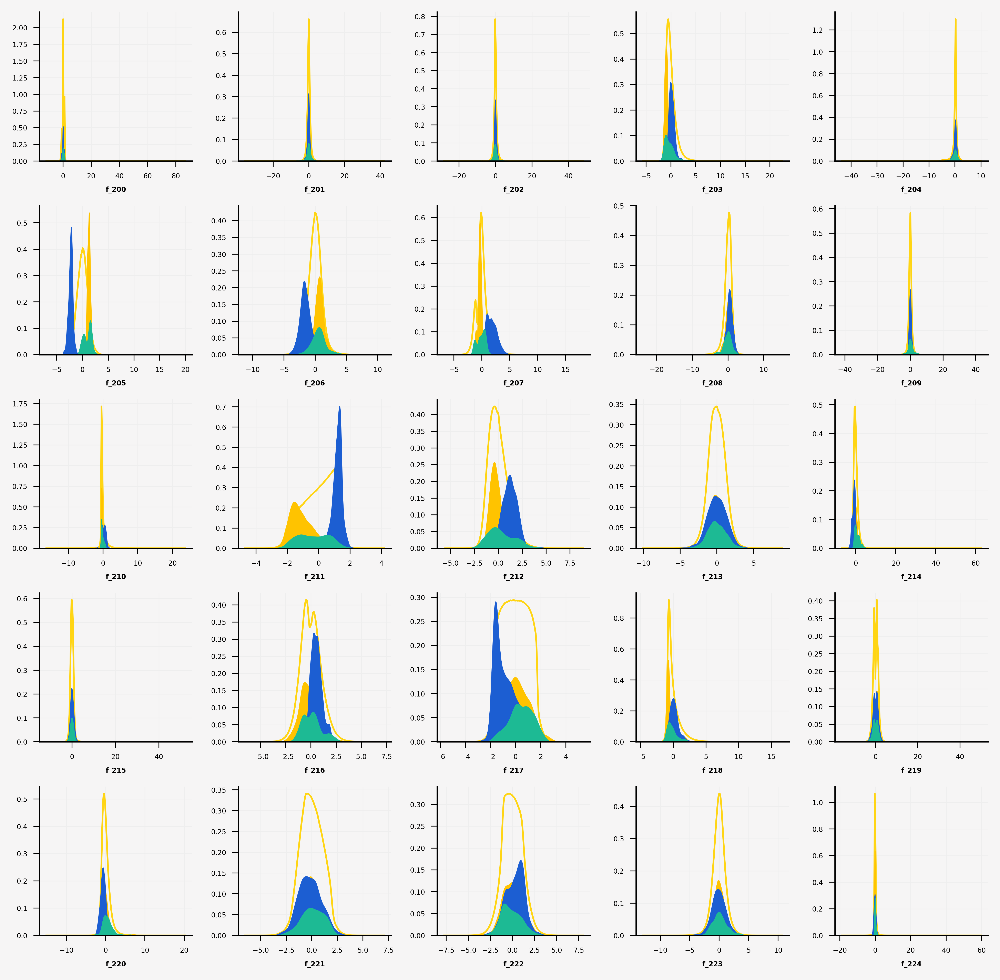

In [182]:
plot_feature_distribution(train, list(train.columns[204:229]), 'images/feature_importance_200_224.png')

### f_225 - f_249

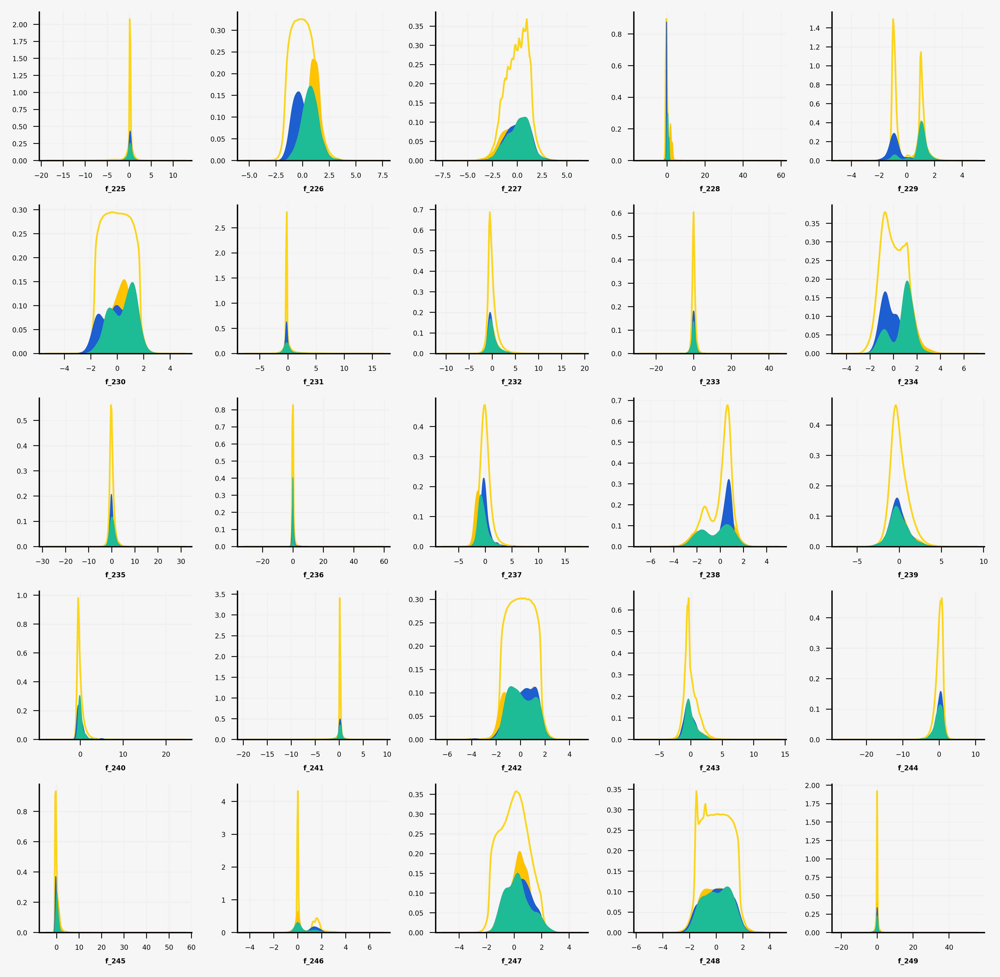

In [183]:
plot_feature_distribution(train, list(train.columns[229:254]), 'images/feature_importance_225_249.png')

### f_250 - f_274

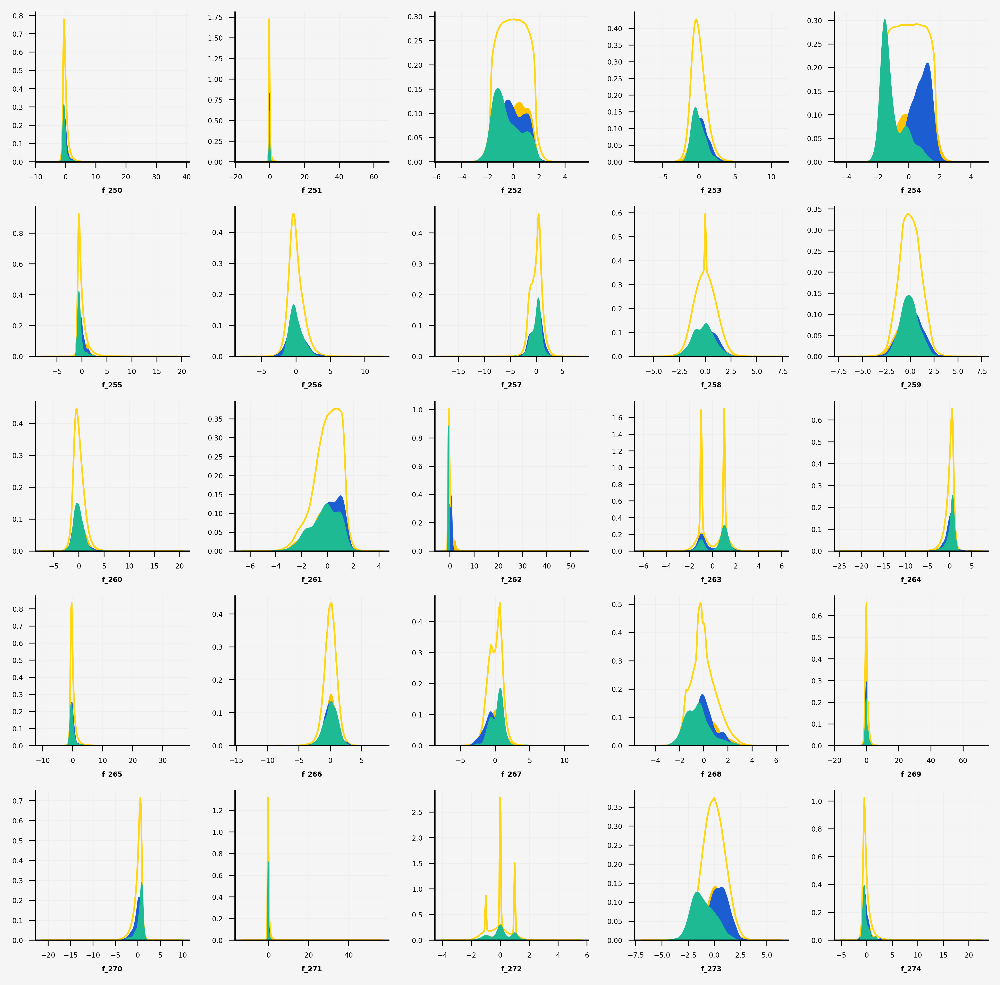

In [184]:
plot_feature_distribution(train, list(train.columns[254:279]), 'images/feature_importance_250_274.png')

### f_275 - f_300

## Correlation of Feature Pairs

In [74]:
train_sub = train.sample(frac=0.2)
cols = [f'f_{i}' for i in range(300)] + ['target']

In [95]:
def plot_heatmap(df, depend):
    '''Plot the heatmap based on correlation or mutual information.
    
    Parameters:
        df: pd.DataFrame, measure of mutual dependence betweeb each 
            featue pair
        depend: str, name of dependence, the choices are as follows:
            {'Corr', 'NMI'}
            
    Return:
        None
    '''
    fig = go.Figure()
    fig.add_trace(go.Heatmap(x=df.index, 
                             y=df.columns, 
                             z=df.T, 
                             colorbar=dict(title=depend), 
                             hoverinfo='text',
                             text=get_hover_text(df)))
    fig.update_layout(
        title=f"{depend} of Feature Pairs",
        xaxis_title="Feature1 (Including target)",
        yaxis_title="Feature2 (Including target)",
        width=1200, height=800
    )
    fig_widget = go.FigureWidget(fig)
    fig_widget.show()

In [71]:
def get_hover_text(df):
    '''Return text list storing hover information for interactive 
    heatmap.
    
    Parameters:
        df: pd.DataFrame, measure of mutual dependence betweeb each 
            featue pair
        
    Return:
        hover_txt: list, hover information displayed when hovering 
                   grids in the heatmap
    '''
    hover_txt = []
    for yi, feat_y in enumerate(df.columns):
        hover_txt.append([])
        for xi, feat_x in enumerate(df.index):
            hover_txt[-1].append(f"Feature1: {feat_x}<br />Feature2: {feat_y} "
                                 f"<br />Score: {df[feat_y][feat_x]}")
    return hover_txt

In [ ]:
corrs = train_sub[cols].corr()

There are indeed some highly correlated features

In [96]:
plot_heatmap(corrs[abs(corrs)>.7], depend='Corr')

## Correlation with Predicting Target

There is no strong correlation between features and target. 

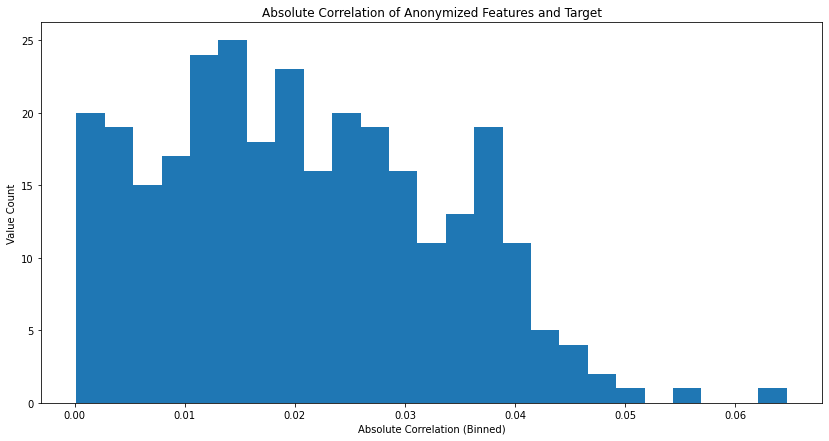

Maximum absolute correlation with target is 0.06469835710596893, and the corresponding feature is 231


In [98]:
corrs_with_target = corrs.loc[:, 'target']
corrs_with_target = corrs_with_target[corrs_with_target.index != 'target']
corrs_with_target = abs(corrs_with_target)

fig, ax = plt.subplots(figsize=(14, 7))
ax.hist(corrs_with_target, bins=25)
ax.set_title("Absolute Correlation of Anonymized Features and Target")
ax.set_xlabel("Absolute Correlation (Binned)")
ax.set_ylabel("Value Count")
fig.savefig('images/corr_w_target.png', dpi=100)
plt.show()
print(f"Maximum absolute correlation with target is {corrs_with_target.max()}, "
      f"and the corresponding feature is {corrs_with_target.argmax()}")

## Correlation between cumulated features and cumulated target

In [118]:
corr = []
for i in range(300):
    corr.append( train['target'].cumsum().corr(train[f'f_{i}'].cumsum()) )

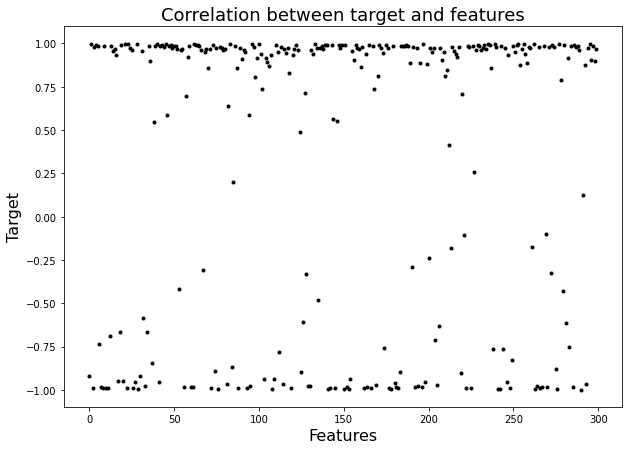

In [119]:
plt.figure(figsize=(10,7))
plt.plot(corr, 'k.')
plt.xlabel('Features', fontsize=16)
plt.ylabel('Target', fontsize=16)
plt.title('Correlation between target and features', fontsize=18)
plt.savefig('images/corr_cumulated_target_w_cumulated_features.png', dpi=100)
plt.show()

There are 202 correlations with an absolute correlation coefficient over 0.95

In [120]:
len([idx for idx, elem in enumerate(corr) if abs(elem)>0.95])w

202

# Helper Function

In [173]:
def plot_feature_distribution(train, features, image_file_path):
    plt.rcParams['figure.dpi'] = 600
    fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
    gs = fig.add_gridspec(5, 5)
    gs.update(wspace=0.3, hspace=0.3)
    background_color = '#f6f5f5'
    run_no = 0

    colormap = ['#1DBA94','#1C5ED2', '#FFC300', '#C70039']
    plt.rc('axes', prop_cycle=(cycler('color', colormap)))

    for row in range(0, 5):
        for col in range(0, 5):
            locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
            locals()["ax"+str(run_no)].set_facecolor(background_color)
            for s in ["top","right"]:
                locals()["ax"+str(run_no)].spines[s].set_visible(False)
            run_no += 1  

    inv_ids = random.choices(train['investment_id'].unique(), k=3)
    run_no = 0
    for col in features:
        sns.kdeplot(ax=locals()["ax"+str(run_no)], x=train[col], zorder=2, alpha=1, linewidth=1, color='#ffd514')
        sns.kdeplot(ax=locals()["ax"+str(run_no)], x=train[train['investment_id'].isin(inv_ids)][col], hue=train[train['investment_id'].isin(inv_ids)]['investment_id'],zorder=2, alpha=1, fill=True, color=colormap, linewidth=0.5, legend=False,palette=colormap[:3], hue_order=inv_ids.sort(reverse=True))

        locals()["ax"+str(run_no)].grid(which='major', axis='x', zorder=0, color='#EEEEEE', linewidth=0.4)
        locals()["ax"+str(run_no)].grid(which='major', axis='y', zorder=0, color='#EEEEEE', linewidth=0.4)
        locals()["ax"+str(run_no)].set_ylabel('')
        locals()["ax"+str(run_no)].set_xlabel(col, fontsize=4, fontweight='bold')
        locals()["ax"+str(run_no)].tick_params(labelsize=4, width=0.5)
        locals()["ax"+str(run_no)].xaxis.offsetText.set_fontsize(4)
        locals()["ax"+str(run_no)].yaxis.offsetText.set_fontsize(4)

        run_no += 1
    plt.savefig(image_file_path)
    plt.show()